In [1]:
import urllib.request
import re
import requests
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import json
from sklearn.metrics import r2_score
import time
import powerlaw
from networkx.algorithms.community.centrality import girvan_newman
from fa2 import ForceAtlas2
import os 
import glob
import nltk, pprint
from nltk import word_tokenize
from nltk.corpus import stopwords 
from nltk import FreqDist 
import wordcloud 
from wordcloud import WordCloud, STOPWORDS
import string
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from nltk import pos_tag
import os 
import glob
import nltk, pprint
from nltk import word_tokenize
from nltk.corpus import stopwords 
from nltk import FreqDist 
import wordcloud 
from wordcloud import WordCloud, STOPWORDS
import string
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from nltk.corpus import wordnet
nltk.download('wordnet')
from matplotlib.patches import Patch
from matplotlib.lines import Line2D
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()
from sklearn.feature_extraction.text import CountVectorizer
import matplotlib.pyplot as plt
import seaborn as sns

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\rolfe\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [2]:
#function used to get wikilink from an imdb id
def imdbId_to_wikiLink(imdbId):

    imdbId = str(imdbId)
    
    while len(imdbId)<7:
        imdbId = str(0) + imdbId  

    url = 'https://query.wikidata.org/sparql'
    query = '''
    SELECT ?wppage WHERE {                                                          
    ?subject wdt:P345 'tt''' + imdbId + '''' .                                                   
      ?wppage schema:about ?subject .                                               
      FILTER(contains(str(?wppage),'//en.wikipedia'))                               
    }
    '''
    r = requests.get(url, params = {'format': 'json', 'query': query})
    while (r.status_code == 429):
        time.sleep(0.1)
        r = requests.get(url, params = {'format': 'json', 'query': query})
    data = r.json()
    if (len(data['results']['bindings']) == 0):
        return None
        
    weblink = data['results']['bindings'][0]['wppage']['value']

    
    wikilink = ''
    
    #match the last /wikilink part of url
    regex = re.compile(r".+\/(.+)")
    wikimatch = re.search(regex, weblink)
    
    if wikimatch is not None:
        wikilink = wikimatch.group(1)
    
    return wikilink

In [3]:
#function used to get the wikitext from a wikilink
def wikiLink_to_wikiText(wikiLink):

    #as described at https://www.mediawiki.org/wiki/API:Tutorial
    baseurl = "https://en.wikipedia.org/w/api.php?"
    action = "action=query"
    content = "prop=revisions&rvprop=content"
    dataformat ="format=json"
    
    title = "titles={}".format(wikilink)
    query = "{}{}&{}&{}&{}".format(baseurl, action, content, title, dataformat)
    wikiresponse = urllib.request.urlopen(query)
    wikidata = wikiresponse.read()
    wikitext = wikidata.decode('utf-8')
    
    return wikitext

In [4]:
#function used to check wether or not two movies share a genre
def genre_in_common(movie1, movie2):
    
    #define the to list of genres
    G1 = G.nodes[movie1]['genres']
    G2 = G.nodes[movie2]['genres']
    
    #make list of genres in common
    common = [i for i in G1 if i in G2]
    
    if (len(common)>0):
        return True
    return False

In [5]:
#function returning movie with strongest connection to the given movie id
def suggestMovie(movieId):
    
    #used to keep track of strongest link to other movie
    max_weight = 0
    
    for edge in G.edges(movieId):
        
        #if link is the strongest we've seen, then save it
        if G[edge[0]][edge[1]]['weight'] > max_weight:
            max_weight = G[edge[0]][edge[1]]['weight']
            recommended_edge = edge
    
    #return the recommended movie from the strongest link
    if recommended_edge[0] != movieId:
        recommended_movie = recommended_edge[0]
    else:
        recommended_movie = recommended_edge[1]
        
    return G.nodes[recommended_movie]['title']  

In [6]:
#function used to get a yearly average of average ratings
def get_yearly_avg(year):
    
    #used to calculate average
    count = 0
    sum = 0
    
    for movie in G.nodes:
        
        #match numbers in ()
        match = re.search(r"\(([0-9]*?)\)", G.nodes[movie]['title'])
        
        if (match is not None):
            
            #if movie is from year, update count and sum
            if (int(match.group(1)) == year):
                count += 1
                sum += G.nodes[movie]['avg_rating']
                
    if (count == 0):
        return 0
    return (sum/count)

In [7]:
#function used when converting between movie id and filetitle. Both used when saving wikitexts to files and when reading from them.
def movieId_to_filetitle(movieId):
    illegal = ['#','%','&','{','}','\\','$','!','\'','"',':','<','>','*','?','/',' ','+','`','|','=']

    fileTitle = G.nodes[movieId]['title'] + '.txt'
    
    for sign in illegal:
        fileTitle = fileTitle.replace(sign,'_')
    return fileTitle

First we save all the needed data from the datasets locally.

In [8]:
readerLinks = pd.read_csv('links.csv')
readerMovies = pd.read_csv('movies.csv')
readerRatings = pd.read_csv('ratings.csv')

In [9]:
links = []
for i in range(len(readerLinks)):

    movieId = readerLinks.iloc[i,0]
    imdbId = readerLinks.iloc[i,1]
    
    links.append([movieId, imdbId])

In [10]:
movies = []
for i in range(len(readerMovies)):

    movieId = readerMovies.iloc[i,0]
    titel = readerMovies.iloc[i,1]
    genres = readerMovies.iloc[i,2]
    
    movies.append([movieId, titel, genres])

In [11]:
ratings = []
for i in range(len(readerRatings)):

    userId = readerRatings.iloc[i,0]
    movieId = readerRatings.iloc[i,1]
    rating = readerRatings.iloc[i,2]
    
    ratings.append([userId, movieId, rating])

Now we create a graph to keep the information in. We make a node for every movie and connect two movies if a user loved both of them

In [12]:
G = nx.Graph()

In [13]:
for movie in movies:
    
    #make list of genres from string of genres
    genres = re.findall(r"([^|]+)",movie[2])
    
    G.add_node(movie[0], title=movie[1], avg_rating=0, rating_count=0, genres=genres,)

In [14]:
#user likes everything rated limit_for_love or higher
limit_for_love = 4

#for every movie loved by user, make a link/increase weight of existing link, to movies also loved by user
for i in range(len(ratings)):
    
    #defining movie
    movie = ratings[i][1]
    
    #update average rating of movie
    old_average = G.nodes[movie]['avg_rating']
    old_count = G.nodes[movie]['rating_count']
    
    G.nodes[movie]['rating_count'] += 1
    G.nodes[movie]['avg_rating'] = (old_average*old_count + ratings[i][2])/G.nodes[movie]['rating_count']
    
    #if user doesnt love movie dont bother linking to it
    if (ratings[i][2] < limit_for_love):
        continue
    
    #increase index to avoid linking to itself
    j = i+1
    
    #avoid out of range
    if(j < len(ratings)):
        
        #look at all other ratings made by same user
        while (ratings[j][0] == ratings[i][0]):
            
            second_movie = ratings[j][1]
            
            #if the user loves second_movie and the two movies share a genre, add an edge between them or increase weight of existing
            if (ratings[j][2] >= limit_for_love and genre_in_common(movie, second_movie)):
                if (G.has_edge(movie, second_movie)):
                    G[movie][second_movie]['weight'] += 1 #increase weight on existing edge
                else:
                    G.add_edge(movie, ratings[j][1], weight=1) #or create new edge
            j+=1
            if (j>=len(ratings)):
                break

We now want to take a look at the degree distribution.

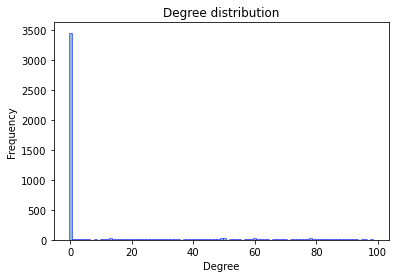

In [15]:
degrees = [G.degree(n, weight = 'weight') for n in G.nodes()]

hist = plt.hist(degrees, edgecolor='blue', alpha=0.5, align='left', bins=range(0,100), label='movies')

plt.title('Degree distribution')
plt.xlabel("Degree")
plt.ylabel("Frequency")

plt.savefig('degree.png')

Calculating best minimal value for power law fit
Alpha = -3.380305350690553


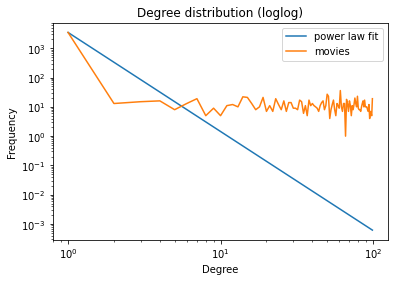

In [16]:
degrees = [G.degree(n, weight = 'weight') for n in G.nodes()]

hist = np.histogram(degrees, bins=range(0,100))

x = hist[1][1:]
y = hist[0]

alpha = powerlaw.Fit(hist[0]).alpha
fit = [i**(-alpha)*max(hist[0]) for i in x]

plt.plot(x,fit, label='power law fit')
plt.loglog(x, y, label='movies')

plt.legend(loc=1)
plt.title('Degree distribution (loglog)')
plt.xlabel("Degree")
plt.ylabel("Frequency")

plt.savefig('loglog.png')

print('Alpha = -{}'.format(alpha))

The network does not seem to follow a power law distribution, as made visible by the non-linear orange line in the log-log plot.

For the sake of investigation we plotted the average ratings over time. This will come into use in the sentiment analysis.

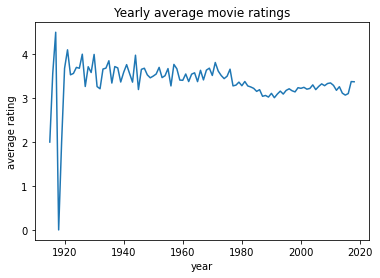

In [17]:
x = []
y = []

for i in range(1915,2019):
    y.append(get_yearly_avg(i))
    x.append(i)
  
plt.plot(x, y)
  
plt.xlabel('year')
plt.ylabel('average rating')
  
plt.title('Yearly average movie ratings')
  
plt.show()

In [18]:
#downloading wikitexts
#movie_txt = []

#for link in links:
    
#    movieId = link[0]
#    imdbId = link[1]
    
#    fileTitle = movieId_to_filetitle(movieId)
    
#    wikilink = imdbId_to_wikiLink(imdbId)
#    if wikilink is None:
#        continue
    
#    wikitext = wikiLink_to_wikiText(wikilink)
    
#    f = open('wikitexts/' + fileTitle, 'w')
#    f.write(json.dumps(json.loads(wikitext)))   

To help us place some lower boundaries for certain values, we made a few plots.

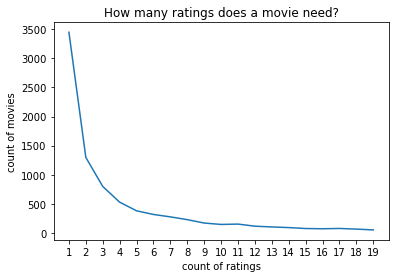

In [22]:
x = []
y = []
for i in range(20):
    movies = 0
    for node in G.nodes:
        if (G.nodes[node]['rating_count'] == i):
            movies += 1
    x.append(i)
    y.append(movies)

plt.xticks(range(1,20))
plt.plot(x[1:], y[1:])
  
plt.xlabel('count of ratings')
plt.ylabel('count of movies')
  
plt.title('How many ratings does a movie need?')
  
plt.savefig('rating.png')

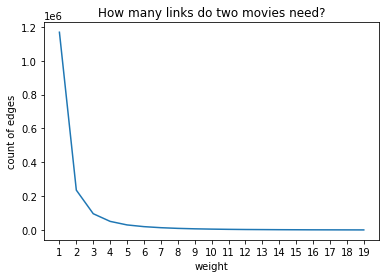

In [21]:
x = []
y = []
for i in range(20):
    edges = 0
    for edge in G.edges:
        if (G[edge[0]][edge[1]]['weight'] == i):
            edges += 1
    x.append(i)
    y.append(edges)

plt.plot(x[1:], y[1:])
plt.xticks(range(1,20))
  
plt.xlabel('weight')
plt.ylabel('count of edges')
  
plt.title('How many links do two movies need?')
  
plt.savefig('links.png')

In [1]:
#placing lower boundaries
min_ratings = 10
min_weight = 3

Checking amount of nodes and edges before putting enabling the lower boundaries.

In [16]:
len(G.nodes)

9742

In [17]:
len(G.edges)

1664844

We now removing the nodes/edges that do not satisfy the lower boundaries.

In [18]:
#keep only strong movies

to_remove = []

for node in G.nodes:
    if (G.nodes[node]['rating_count'] < min_ratings):
            to_remove.append(node)
        
G.remove_nodes_from(to_remove)

In [19]:
len(G.nodes)

2269

In [20]:
len(G.edges)

676640

In [21]:
#keep only strong links

to_remove = []

for edge in G.edges:    
    if G[edge[0]][edge[1]]["weight"] < min_weight:
            to_remove.append(edge)
        
G.remove_edges_from(to_remove)

In [22]:
len(G.nodes)

2269

In [23]:
len(G.edges)

239269

We also only keep the strongest weakly connected component.

In [24]:
#weakly_connected_components only works on directed graphs
G_directed = G.to_directed()
Gsub = max(nx.weakly_connected_components(G_directed))
Gsub = nx.subgraph(G, Gsub)
Gsub = Gsub.to_undirected()

In [25]:
len(Gsub.nodes)

2007

In [26]:
len(Gsub.edges)

239269

Now we visualize the network.

In [2]:
#assigning colors depending on average rating and size depending on amount of ratings.
colors = []
sizes = []

for node in Gsub.nodes:
    colors.append(Gsub.nodes[node]['avg_rating'])
    sizes.append(int(Gsub.nodes[node]['rating_count'])**2)

NameError: name 'Gsub' is not defined

In [31]:
forceatlas = ForceAtlas2(gravity = 1)

In [32]:
positions = forceatlas.forceatlas2_networkx_layout(Gsub, pos=None, iterations= 1000)

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [01:16<00:00, 13.01it/s]

BarnesHut Approximation  took  13.82  seconds
Repulsion forces  took  57.50  seconds
Gravitational forces  took  0.16  seconds
Attraction forces  took  3.84  seconds
AdjustSpeedAndApplyForces step  took  0.62  seconds


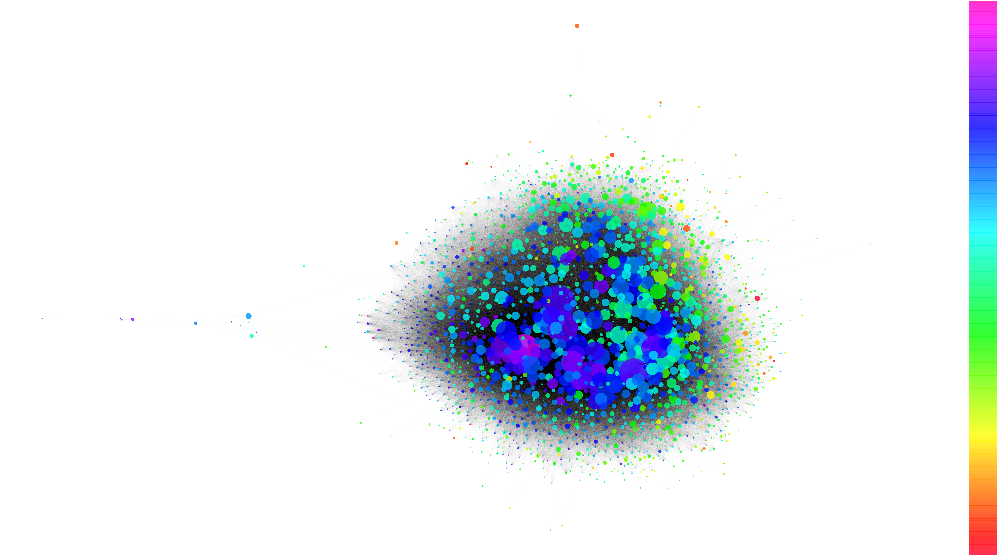

In [48]:
fig = plt.figure(1, figsize=(200, 100), dpi=60)

nodes = nx.draw_networkx_nodes(Gsub, positions, alpha=0.8, node_color = colors, node_size = sizes, cmap=plt.cm.gist_rainbow)

#making the opacity of the edges depend on their weight
max_weight = max(Gsub[edge[0]][edge[1]]['weight'] for edge in Gsub.edges)
for edge in Gsub.edges(data="weight"):
    nx.draw_networkx_edges(Gsub, positions, edgelist=[edge], alpha = (edge[2]/max_weight))

plt.colorbar(nodes)

plt.savefig('g.png')

plt.show()

For the sake of further investigation, we plot average rating against amount of ratings (as meantioned in the report).

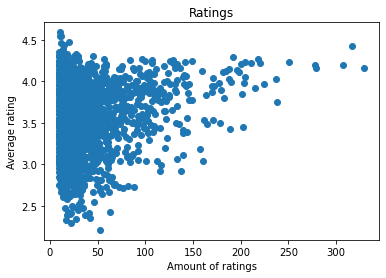

<Figure size 432x288 with 0 Axes>

In [52]:
x = []
y = []
for node in Gsub.nodes:
    x.append(Gsub.nodes[node]['rating_count'])
    y.append(Gsub.nodes[node]['avg_rating'])

plt.scatter(x, y)
  
plt.ylabel('Average rating')
plt.xlabel('Amount of ratings')
  
plt.title('Ratings')
  
plt.show()
plt.savefig('avg_amount.png')

Before further modifying the network, we save a copy of the current version.

In [27]:
Gsub2 = Gsub.copy()

In [29]:
#keep only strongest link

to_keep = []

for node in Gsub2.nodes:    
    
    max = 0
    edge_to_keep = -1
    
    for edge in Gsub2.edges(node):
        if Gsub2[edge[0]][edge[1]]["weight"] > max:
            max = Gsub2[edge[0]][edge[1]]["weight"]
            edge_to_keep = edge
    
    if max == 0:
        print('zero degree')
            
    if edge != -1 and edge not in to_keep:
        to_keep.append(edge_to_keep)

In [31]:
#delete the rest

to_delete = []

for edge in Gsub2.edges:
    if (edge[0], edge[1]) not in to_keep and (edge[1], edge[0]) not in to_keep:
        to_delete.append(edge)

Gsub2.remove_edges_from(to_delete)

In [32]:
len(Gsub2.edges)

2002

In [33]:
len(Gsub2.nodes)

2007

In [33]:
#check that no edges from to_keep were deleted

for edge in to_keep:
    if not Gsub2.has_edge(edge[0],edge[1]):
        print('missing')

On the second version of the network, we make community analysis, plotting the five biggest communities.

In [34]:
communities = girvan_newman(Gsub2)

node_groups = []

for community in next(communities):
  node_groups.append(list(community))

In [50]:
node_groups.sort(key= len, reverse=True)

k = 1
for group in range(5):

    print("Community number: ", k, " Number of nodes:",len(node_groups[group]))
    k = k+1

Community number:  1  Number of nodes: 998
Community number:  2  Number of nodes: 650
Community number:  3  Number of nodes: 302
Community number:  4  Number of nodes: 52
Community number:  5  Number of nodes: 3


In [99]:
forceatlas2 = ForceAtlas2(gravity = 20)

In [100]:
positions2 = forceatlas2.forceatlas2_networkx_layout(Gsub2, pos=None, iterations= 50)

100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 16.47it/s]

BarnesHut Approximation  took  0.36  seconds
Repulsion forces  took  2.53  seconds
Gravitational forces  took  0.02  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.05  seconds


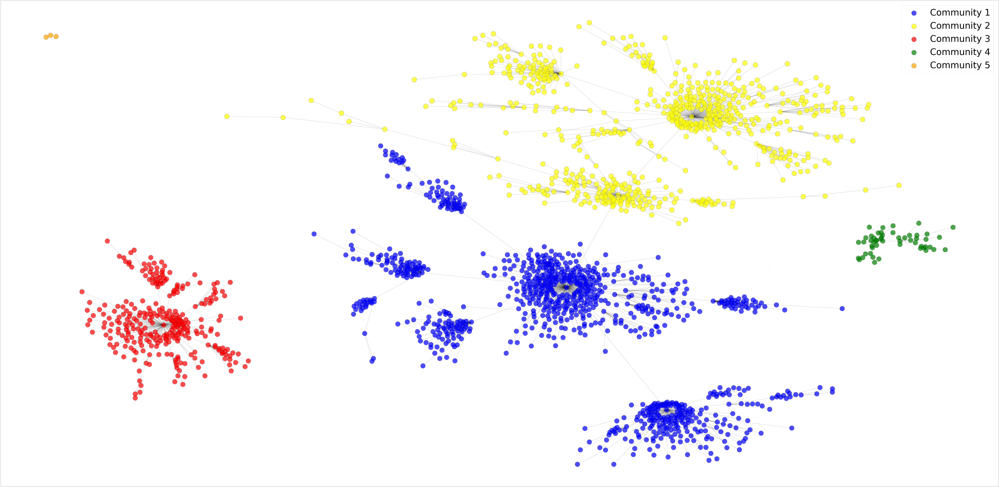

In [101]:
fig = plt.figure(1, figsize=(200, 100), dpi=60)

nx.draw_networkx_nodes(node_groups[0], positions2, alpha=0.7, node_color = 'blue', node_size = 3000, edgecolors = 'black', label = 'Community 1')
nx.draw_networkx_nodes(node_groups[1], positions2, alpha=0.7, node_color = 'yellow', node_size = 3000, edgecolors = 'black', label = 'Community 2')
nx.draw_networkx_nodes(node_groups[2], positions2, alpha=0.7, node_color = 'red', node_size = 3000, edgecolors = 'black', label = 'Community 3')
nx.draw_networkx_nodes(node_groups[3], positions2, alpha=0.7, node_color = 'green', node_size = 3000, edgecolors = 'black', label = 'Community 4')
nx.draw_networkx_nodes(node_groups[4], positions2, alpha=0.7, node_color = 'orange', node_size = 3000, edgecolors = 'black', label = 'Community 5')

nx.draw_networkx_edges(Gsub2, positions2, alpha=0.5)

plt.legend(scatterpoints = 1)
plt.legend(loc=1, prop={'size': 100})

plt.savefig('com.png')

Not we visualize the communities along side the original network.

In [103]:
communities = node_groups[0]+node_groups[1]+node_groups[2]+node_groups[3]+node_groups[4]
not_in_community = [node for node in list(Gsub.nodes) if node not in communities]

In [104]:
#make size depend on amount of ratings
com1_sizes = []
com2_sizes = []
com3_sizes = []
com4_sizes = []
com5_sizes = []
nocom_sizes = []

for node in node_groups[0]:
    com1_sizes.append(int(Gsub2.nodes[node]['rating_count'])**2)

for node in node_groups[1]:
    com2_sizes.append(int(Gsub2.nodes[node]['rating_count'])**2)
    
for node in node_groups[2]:
    com3_sizes.append(int(Gsub.nodes[node]['rating_count'])**2)
    
for node in node_groups[3]:
    com4_sizes.append(int(Gsub.nodes[node]['rating_count'])**2)
    
for node in node_groups[4]:
    com5_sizes.append(int(Gsub.nodes[node]['rating_count'])**2)
    
for node in not_in_community:
    nocom_sizes.append(int(Gsub.nodes[node]['rating_count'])**2)
    

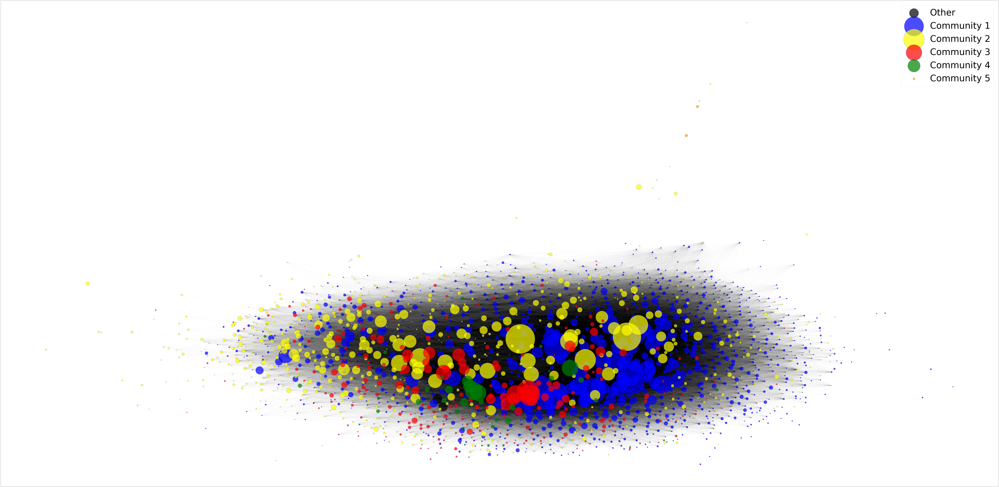

In [105]:
fig = plt.figure(1, figsize=(200, 100), dpi=60)

nx.draw_networkx_nodes(not_in_community, positions, alpha=0.7, node_color = 'black', node_size = nocom_sizes, label = 'Other').set_edgecolor('b')

nx.draw_networkx_nodes(node_groups[0], positions, alpha=0.7, node_color = 'blue', node_size = com1_sizes, edgecolors = 'black', label = 'Community 1').set_edgecolor('b')
nx.draw_networkx_nodes(node_groups[1], positions, alpha=0.7, node_color = 'yellow', node_size = com2_sizes, edgecolors = 'black', label = 'Community 2').set_edgecolor('b')
nx.draw_networkx_nodes(node_groups[2], positions, alpha=0.7, node_color = 'red', node_size = com3_sizes, edgecolors = 'black', label = 'Community 3').set_edgecolor('b')
nx.draw_networkx_nodes(node_groups[3], positions, alpha=0.7, node_color = 'green', node_size = com4_sizes, edgecolors = 'black', label = 'Community 4').set_edgecolor('b')
nx.draw_networkx_nodes(node_groups[4], positions, alpha=0.7, node_color = 'orange', node_size = com5_sizes, edgecolors = 'black', label = 'Community 5').set_edgecolor('b')


#max_weight = max(Gsub[edge[0]][edge[1]]['weight'] for edge in Gsub.edges)
for edge in Gsub.edges(data="weight"):
    nx.draw_networkx_edges(Gsub, positions, edgelist=[edge], alpha = (edge[2]/max_weight))

plt.legend(scatterpoints = 1)
plt.legend(loc=1, prop={'size': 100})

plt.savefig('gcom.png')

In [61]:
#function used to determine most frequent element in a list
def most_frequent(List):
    counter = 0
    num = List[0]
     
    for i in List:
        curr_frequency = List.count(i)
        if(curr_frequency> counter):
            counter = curr_frequency
            num = i
 
    return num

In [86]:
#printing most three most frequent genres of every communtity
community = 5

for i in range(5):
    print('Community {}:'.format(i+1))
    
    genres = []
    
    for node in node_groups[i]:
        genres = genres + Gsub.nodes[node]['genres']
    for i in range(3):
        top = most_frequent(genres)
        print(top)
        genres = list(filter(lambda a: a != top, genres))
        if (len(genres) == 0):
            break
    print('\n')

Community 1:
Drama
Thriller
Comedy


Community 2:
Comedy
Drama
Romance


Community 3:
Action
Adventure
Comedy


Community 4:
Adventure
Fantasy
Action


Community 5:
Documentary




In [45]:
# Here all the functions that when into cleaning and preparing the text for TF-IDF.


def get_plot(file):   
    # This function main purpouse is to shorten the wikitext to only plot and remove links.
     
    no_link = re.sub(r"http\S+", " ", file)
    file = re.sub(r'\w*\d\w*', '', no_link).strip()
    
        # We tested with some texts before and saw that you can make a limit by finding the plot start and cast end.
        # So we shorten by plot and cast. And if they cannot find this string index. 
        # we cut by 1000 - to references beginning. If references can't be found. We just take the text as it is.
        
    
    if file.find("==Plot==") != -1 and file.find("==Cast==") != -1 :
        
        
        min = file.find("==Plot==")
        max = file.find("==Cast==")
        plot_file = file[min:max]
            
    elif file.find("References") != -1:
        
        max = file.find("References")
        plot_file = file[1000:max]
           
    else:
         
        plot_file = file
    
    return plot_file
 
    
def words_to_remove():
    
    # This function returns stopwords + our own added stopwords after analysing our text.
    stops= stopwords.words('english')
    
    months = ['january','february','march','april','may','june','july','august','september','october','november']
    Extra_stops = ['plot', 'nin', 'ref','url','www','http','https','com','jsonline','df','n','cite','web','html',
               'mdy','name','article','title','date','webcitation','access','archive','org','movie',
               'website','status']
    Extra = ['webb','film','nmark','critic','critics','publisher','director','editor','deschanel','awards','aa']
    unwanted = stops  + Extra_stops + months + Extra
    
    return unwanted
    
def add_pos_tag(text):
    
    # This function assigns grammatical information on each word.
    # Which is helpful when you lemmanize words.
    
    tagged = pos_tag(cleaning_text(text))
    return tagged 
       
                   
def cleaning_text(raw):
    
    # This functions tokenize text and removies any tokens that does not contain letters. Such as characters, number etc.
    # And sets the words to lowercase.
    
    words = nltk.wordpunct_tokenize(raw)
    
    nonPunct = re.compile('.*[A-Za-z].*') # must contain a letter


    filter  = [w for w in words if nonPunct.match(w)]
    words = [word.lower() for word in filter]
    
    
    
    
            
    return words

def lemmanizing(a_list):
    lemma_text = " "
    for word, pos in a_list:
        if not pos:
            lem = word
            lemma_text = lemma_text + " " + lem
        else:
            lemma = wordnet_lemmatizer.lemmatize(word, pos=pos)
            lemma_text = lemma_text + " " + lemma
    return lemma_text 


 
def remove_unwanted(tagged):
    
    # Final cleaning of the text. 
    # Removes stopwords
    # Tags each word with the grammatical information from pos_dict
    # lemmanize the text. (We get rid of different beindings of a words ex. movie, movies)
    # removing large spaces 
    unwanted = words_to_remove()
    pos_dict = {'J':wordnet.ADJ, 'V':wordnet.VERB, 'N':wordnet.NOUN, 'R':wordnet.ADV}
    pos_list = []
    for word, tag in tagged:
        if word not in unwanted:
            pos_list.append(tuple([word, pos_dict.get(tag[0])]))
           
    final = lemmanizing(pos_list)
    
    
    final = final.translate(str.maketrans("", "", string.punctuation))
    final = "".join([i for i in final if not i.isdigit()]) # removing year and such
    
    while "  " in final:
        
        final = final.replace("  ", " ")
    
    return final

In [46]:
path = 'C:\\Users\\rolfe\\OneDrive - Danmarks Tekniske Universitet\\Skrivebord\\wikitexts'

In [47]:
# We gather the wikitexts for the movies in each comminity.
# Each community equals to 1 document. 
Documents = ['','','','','']

# iterate over files in
Wikitext = os.listdir(path)
count = 0


for i in range(len(node_groups)-1):
    for movie in node_groups[i]:
        file_name = movieId_to_filetitle(movie)
        try:
            with open(path + '\\' + file_name) as f:
                file = f.read()
                file = get_plot(file)
                file_word = pos_tag(cleaning_text(file))
                file_word = remove_unwanted(file_word)
                
                Documents[i] += ' ' + file_word
        except IOError:
                print('{} does not exist'.format(file_name))
        

Wallace___Gromit__The_Best_of_Aardman_Animation_(1996).txt does not exist
Creature_Comforts_(1989).txt does not exist


IndexError: list index out of range

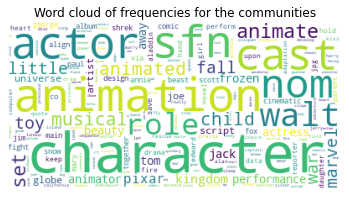

In [52]:
# We use countvectorizer to get the termfrequency for the documents

TF_vect = CountVectorizer(stop_words=words_to_remove(),max_df=.95)
    
TF = TF_vect.fit_transform(Documents)
TF_trans = TF.toarray()
doc = TF_trans[(TF_trans>15).any(axis=1)]
words = np.array(TF_vect.get_feature_names())
    
#cath words that actually occur in the document 
doc = doc[1] 
index = (doc>0)
doc_words = words[index]
doc_counts = doc[doc>0]
    
    
# combine word and count
frequencies = dict(zip(doc_words, doc_counts))
wordcloud = WordCloud(background_color='white').fit_words(frequencies)
plt.imshow(wordcloud)
plt.axis('off')
plt.title('Word cloud of frequencies for the communities')
plt.show()
      

# This wordcloud as expected shows words that typical are found in the text of any movie. In regards to promotional topics, awards shows, media koncern.
# Also tells us that alot of the movies are from media company Disney. Just interesting plot to take further into consideration, when discussing in the report.

    
    


In [53]:
# We use function to create the TF-IDF vectors
#calling the TfidfVectorizer

unwanted = words_to_remove() # defining the same stopwords.

vectorizer = TfidfVectorizer(max_df=.7, min_df=1, stop_words=unwanted, use_idf=True, norm=None)

#creates sparse matrix
TFIDF_docu = vectorizer.fit_transform(Documents)

# convert matrix to array
TFIDF_docu_array  = TFIDF_docu.toarray()


#uncomment out the version that fit your version 
feature_names = vectorizer.get_feature_names()
#feature_names = vectorizer.get_feature_names_out()

In [54]:
N_terms = 30
first_vect_tfidf = TFIDF_docu[1]
dfTfidf = first_vect_tfidf.T.todense()


# Print 70 words with highest TFIDF score 

dfTfidf = pd.DataFrame(first_vect_tfidf.T.todense(), index=feature_names, columns=[ "score"])
Top_words = dfTfidf.sort_values(by=["score"],ascending=False).head(N_terms)


Text(0.5, 0, 'TF-IDF Score')

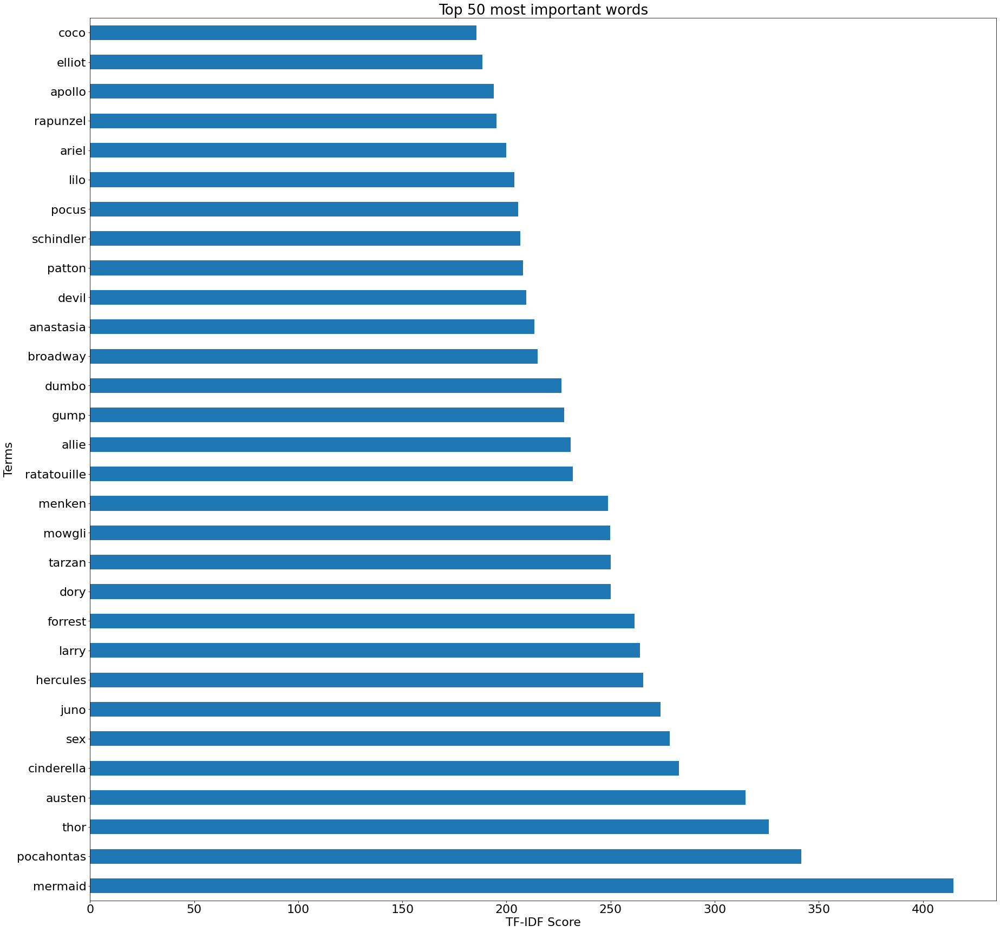

In [55]:
# visualise Top 50 important words
plt.rcParams.update({'font.size': 22})

fig, ax = plt.subplots(figsize=(30, 30))
Top_words['score'].plot(kind="barh", ax=ax)
plt.title("Top 50 most important words")
plt.ylabel("Terms")
plt.xlabel("TF-IDF Score")

In [57]:
# Computing k-means for N = 5 clusters, representing each community
N = 5
model = KMeans(n_clusters=N, init="k-means++", max_iter=1000, n_init=1)
model.fit(TFIDF_docu)
clusters = model.labels_


def get_cluster_Center(n_terms):
    
    # Get the keywords for each centroid of the kmeans
    
    df = pd.DataFrame(TFIDF_docu.todense()).groupby(clusters).mean() # groups the TF-IDF vector by cluster
    terms = vectorizer.get_feature_names() # access tf-idf terms
    for i,r in df.iterrows():
        print('\nCluster: {}'.format(i))
        print(','.join([terms[t] for t in np.argsort(r)[-n_terms:]])) # for each row of the dataframe, find the n terms that have the highest tf idf score




n_terms = 10
# We get the cluster representitive           
clust_cen = get_cluster_Center(1) # the top words in each cluster.

print("\nPrinting top {} terms for each cluster;".format(n_terms))

# Top 10 terms for each cluster overall
clust_cen = get_cluster_Center(n_terms)




Cluster: 0
sex

Cluster: 1
totoro

Cluster: 2
mermaid

Cluster: 3
superman

Cluster: 4
flint

Printing top 10 terms for each cluster;

Cluster: 0
donnie,spectre,ender,malcolm,gremlin,jimmy,harvnb,cameron,fincher,sex

Cluster: 1
hiccup,merida,voldemort,ghibli,panda,rango,nausica,caspian,narnia,totoro

Cluster: 2
forrest,larry,hercules,juno,sex,cinderella,austen,thor,pocahontas,mermaid

Cluster: 3
zemeckis,trooper,starship,harvnb,jaw,conan,snowpiercer,sammon,ghostbusters,superman

Cluster: 4
ffdddd,nmoore,pingatore,oralhistory,grigson,ddffdd,agee,hoop,gm,flint
